In [ ]:

import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from collections import defaultdict

from ultralytics import YOLO
from sklearn.metrics import accuracy_score 

REF_DIR  = "/content/drive/MyDrive/sift_DB/siftimage"
TEST_DIR = "/content/drive/MyDrive/sift_DB/sifttest"
YOLO_MODEL = "/content/yolov8n-face.pt"

IMG_SIZE = (256, 256)
RATIO_TEST = 0.75
RANSAC_THRESH = 5.0
MAX_LINES = 40

def bgr2rgb(img):
    return cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

def show_img(title, img, figsize=(6,4)):
    plt.figure(figsize=figsize)
    plt.imshow(bgr2rgb(img))
    plt.title(title)
    plt.axis("off")
    plt.show()

def show_gray(title, img_gray, figsize=(6,4)):
    plt.figure(figsize=figsize)
    plt.imshow(img_gray, cmap="gray")
    plt.title(title)
    plt.axis("off")
    plt.show()

model = YOLO(YOLO_MODEL)

def detect_faces_yolo(img_bgr):
    res = model(img_bgr, verbose=False)[0]
    faces = []
    img_draw = img_bgr.copy()

    if res.boxes is None or len(res.boxes) == 0:
        return faces, img_draw

    for b in res.boxes:
        x1,y1,x2,y2 = map(int, b.xyxy[0])
        x1 = max(0, x1); y1 = max(0, y1)
        x2 = min(img_bgr.shape[1], x2); y2 = min(img_bgr.shape[0], y2)
        if x2-x1 < 30 or y2-y1 < 30:
            continue

        face = img_bgr[y1:y2, x1:x2].copy()
        face = cv2.resize(face, IMG_SIZE)  

        faces.append(face)
        cv2.rectangle(img_draw, (x1,y1), (x2,y2), (0,255,0), 2)

    return faces, img_draw


In [103]:
sift = cv2.SIFT_create()

def compute_sift(face_bgr):
    gray = cv2.cvtColor(face_bgr, cv2.COLOR_BGR2GRAY)
    kp, des = sift.detectAndCompute(gray, None)
    kp_vis = cv2.drawKeypoints(face_bgr, kp, None,
                               flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    return kp, des, gray, kp_vis


=== RÉFÉRENCES ===


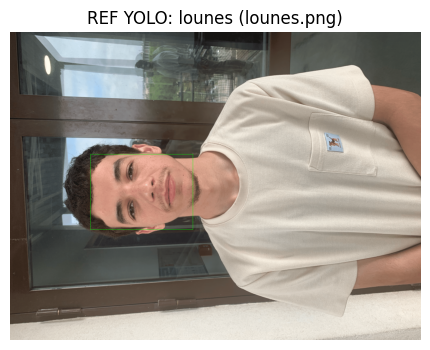

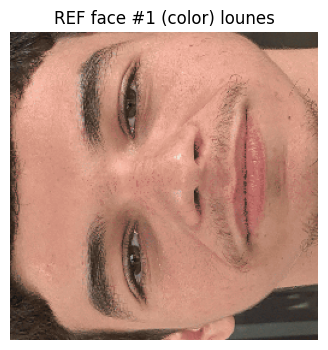

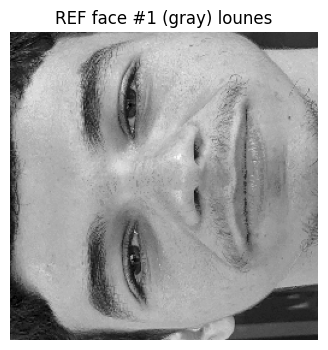

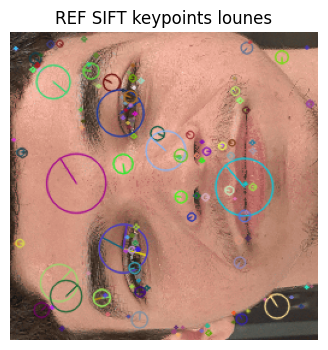

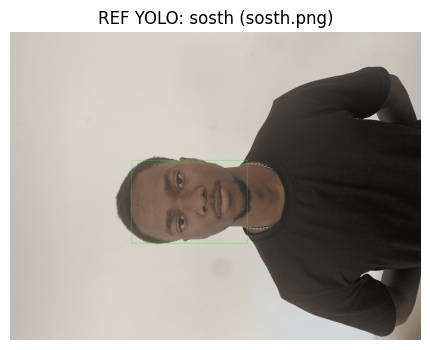

...

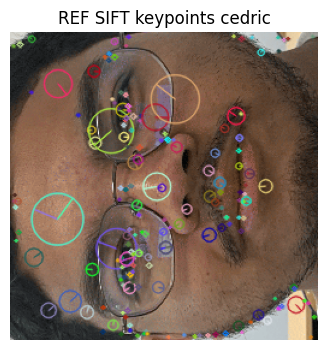

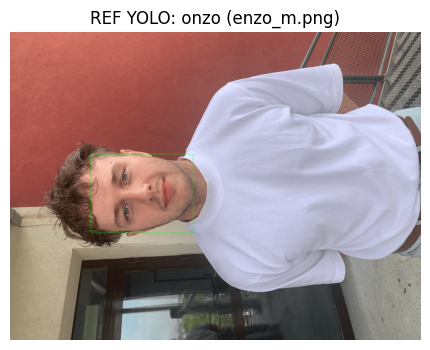

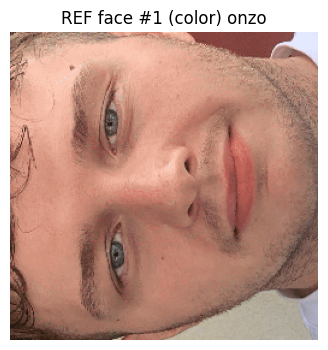

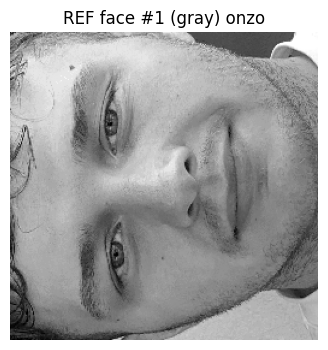

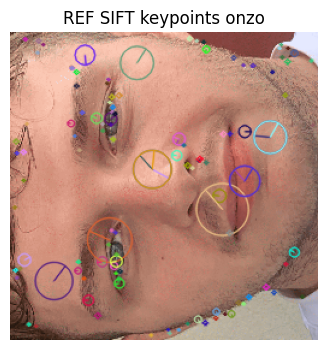

Nb visages références: 18
Identités: ['akil', 'anthony', 'anziza', 'ayoub', 'cedric', 'chams', 'clement', 'lounes', 'maxi', 'melanie', 'moustapha', 'omia', 'onzo', 'samy', 'sosth', 'yanis']


In [104]:
ref_db = []

print("=== RÉFÉRENCES ===")

for person in os.listdir(REF_DIR):
    person_dir = os.path.join(REF_DIR, person)
    if not os.path.isdir(person_dir):
        continue
    label = person.strip().lower()

    for file in os.listdir(person_dir):
        if not file.lower().endswith((".jpg",".png",".jpeg",".bmp")):
            continue

        img = cv2.imread(os.path.join(person_dir, file))
        faces, img_yolo = detect_faces_yolo(img)

        if len(faces) == 0:
            continue

        show_img(f"REF YOLO: {label} ({file})", img_yolo, figsize=(7,4))

        for idx, face in enumerate(faces):
            kp, des, gray, kp_vis = compute_sift(face)

            ref_db.append({
                "label": label,
                "file": file,
                "face": face,
                "kp": kp,
                "des": des
            })

            show_img(f"REF face #{idx+1} (color) {label}", face, figsize=(4,4))
            show_gray(f"REF face #{idx+1} (gray) {label}", gray, figsize=(4,4))
            show_img(f"REF SIFT keypoints {label}", kp_vis, figsize=(4,4))

print("Nb visages références:", len(ref_db))
print("Identités:", sorted(set([r["label"] for r in ref_db])))


=== TESTS ===


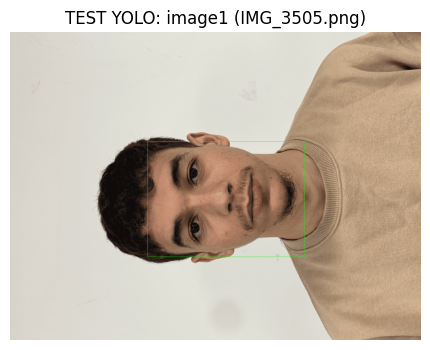

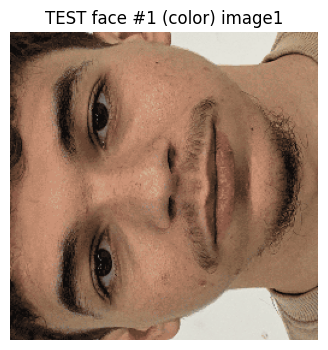

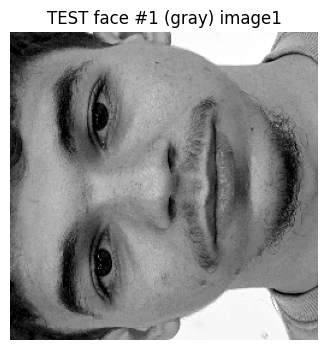

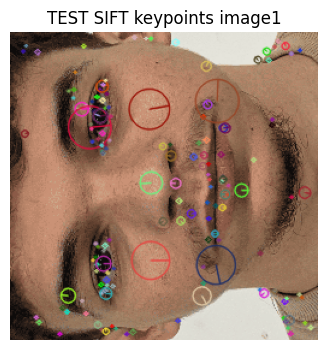

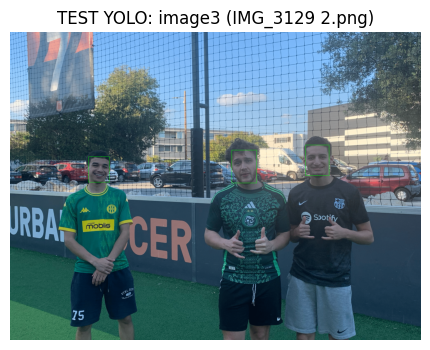

...

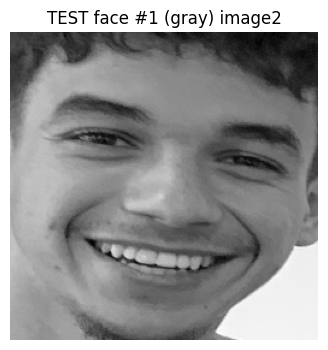

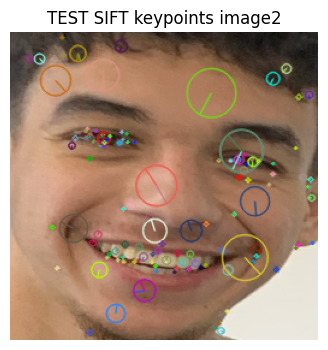

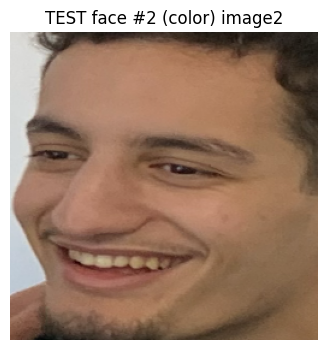

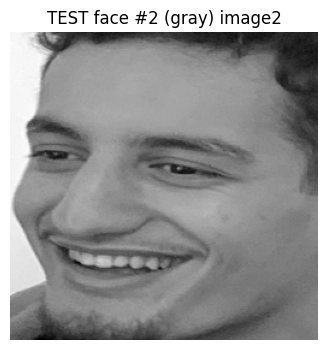

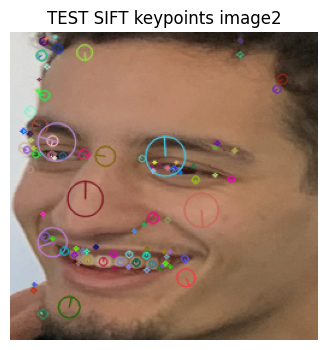

Nb visages test: 6


In [ ]:
test_faces = []

print("===TESTS===")

for person in os.listdir(TEST_DIR):
    person_dir = os.path.join(TEST_DIR, person)
    if not os.path.isdir(person_dir):
        continue
    true_label = person.strip().lower()

    for file in os.listdir(person_dir):
        if not file.lower().endswith((".jpg",".png",".jpeg",".bmp")):
            continue

        img = cv2.imread(os.path.join(person_dir, file))
        faces, img_yolo = detect_faces_yolo(img)

        if len(faces) == 0:
            continue

        show_img(f"TEST YOLO: {true_label} ({file})", img_yolo, figsize=(7,4))

        for idx, face in enumerate(faces):
            kp, des, gray, kp_vis = compute_sift(face)

            test_faces.append({
                "true": true_label,
                "file": file,
                "face_id": idx,
                "face": face,
                "kp": kp,
                "des": des
            })

            show_img(f"TEST face #{idx+1} (color) {true_label}", face, figsize=(4,4))
            show_gray(f"TEST face #{idx+1} (gray) {true_label}", gray, figsize=(4,4))
            show_img(f"TEST SIFT keypoints {true_label}", kp_vis, figsize=(4,4))

print("Nb visages test:", len(test_faces))


In [ ]:
bf = cv2.BFMatcher(cv2.NORM_L2)

def ratio_good_matches(des_ref, des_test, ratio=0.75):
    if des_ref is None or des_test is None:
        return []
    knn = bf.knnMatch(des_ref, des_test, k=2)
    good = []
    for m_n in knn:
        if len(m_n) != 2:
            continue
        m, n = m_n
        if m.distance < ratio * n.distance:
            good.append(m)
    return good

def ransac_inliers_and_warp(ref_face, kp_r, des_r, test_face, kp_t, des_t):
    good = ratio_good_matches(des_r, des_t, ratio=RATIO_TEST)
    if len(good) < 4:
        return 0, good, None, None, None

    pts_r = np.float32([kp_r[m.queryIdx].pt for m in good]).reshape(-1,1,2)
    pts_t = np.float32([kp_t[m.trainIdx].pt for m in good]).reshape(-1,1,2)

    H, mask = cv2.findHomography(pts_t, pts_r, cv2.RANSAC, RANSAC_THRESH)
    if H is None or mask is None:
        return 0, good, None, None, None

    inliers = int(mask.sum())

    h, w = ref_face.shape[:2]
    test_warp = cv2.warpPerspective(test_face, H, (w, h))

    gray_w = cv2.cvtColor(test_warp, cv2.COLOR_BGR2GRAY)
    kp_w, des_w = sift.detectAndCompute(gray_w, None)

    return inliers, good, test_warp, kp_w, des_w


In [107]:
ref_by_id = defaultdict(list)
for r in ref_db:
    ref_by_id[r["label"]].append(r)

def best_for_identity(tf, refs):
    best = {"score": -1, "ref": None, "good": None, "warp": None, "kpw": None, "desw": None}
    for r in refs:
        inliers, good, warp, kpw, desw = ransac_inliers_and_warp(
            r["face"], r["kp"], r["des"],
            tf["face"], tf["kp"], tf["des"]
        )
        if inliers > best["score"]:
            best = {"score": inliers, "ref": r, "good": good, "warp": warp, "kpw": kpw, "desw": desw}
    return best

def top3_identities_for_face(tf):
    scores = []
    for label, refs in ref_by_id.items():
        best = best_for_identity(tf, refs)
        scores.append({"label": label, **best})
    scores.sort(key=lambda x: x["score"], reverse=True)
    return scores[:3]


In [112]:
bf = cv2.BFMatcher(cv2.NORM_L2)

def sift_match_score(ref, test, ratio=0.75):
    """
    ref, test : dict avec keys [face, kp, des]
    Retourne : inliers, good_matches
    """

    if ref["des"] is None or test["des"] is None:
        return 0, []

    matches = bf.knnMatch(ref["des"], test["des"], k=2)

    good = []
    for m, n in matches:
        if m.distance < ratio * n.distance:
            good.append(m)

    if len(good) < 4:
        return 0, good

    pts_ref = np.float32([ref["kp"][m.queryIdx].pt for m in good])
    pts_test = np.float32([test["kp"][m.trainIdx].pt for m in good])

    _, mask = cv2.findHomography(
        pts_ref, pts_test,
        cv2.RANSAC, 5.0
    )

    inliers = int(mask.sum()) if mask is not None else 0
    return inliers, good


In [113]:
from collections import defaultdict

ref_by_identity = defaultdict(list)
for r in ref_db:
    ref_by_identity[r["label"]].append(r)


In [114]:
def top3_for_test_face(test_face):
    scores = []

    for label, refs in ref_by_identity.items():
        best_score = 0
        best_ref = None
        best_good = None

        for ref in refs:
            score, good = sift_match_score(ref, test_face)
            if score > best_score:
                best_score = score
                best_ref = ref
                best_good = good

        scores.append({
            "label": label,
            "score": best_score,
            "ref": best_ref,
            "good": best_good
        })

    scores.sort(key=lambda x: x["score"], reverse=True)
    return scores[:3]


In [115]:
def show_top3_matches(test_face, top3, max_lines=40):
    for i, item in enumerate(top3, 1):

        ref = item["ref"]
        good = item["good"]

        if ref is None or good is None or len(good) == 0:
            print(f"Top-{i}: {item['label']} (pas de matches)")
            continue

        good = sorted(good, key=lambda m: m.distance)[:max_lines]

        match_img = cv2.drawMatches(
            ref["face"], ref["kp"],
            test_face["face"], test_face["kp"],
            good,
            None,
            flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS
        )

        plt.figure(figsize=(14,4))
        plt.imshow(cv2.cvtColor(match_img, cv2.COLOR_BGR2RGB))
        plt.title(f"Top-{i} : {item['label']} | inliers={item['score']}")
        plt.axis("off")
        plt.show()



=== TEST FACE #1 | TRUE=image1 ===
Top-1: lounes | inliers=8
Top-2: cedric | inliers=6
Top-3: sosth | inliers=4


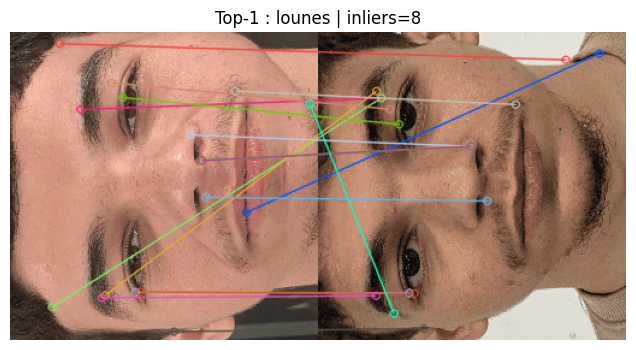

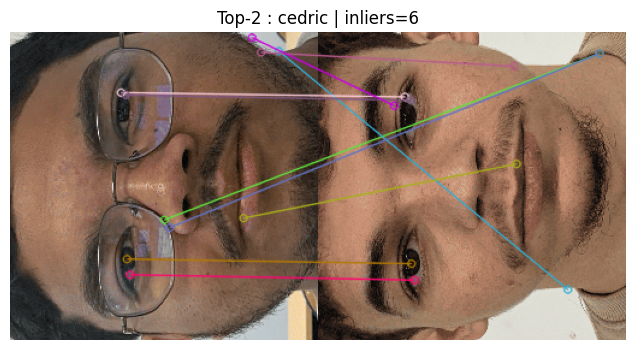

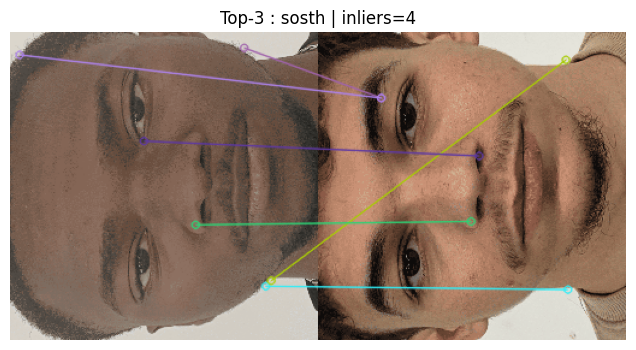


=== TEST FACE #2 | TRUE=image3 ===
Top-1: lounes | inliers=4
Top-2: ayoub | inliers=4
Top-3: clement | inliers=4


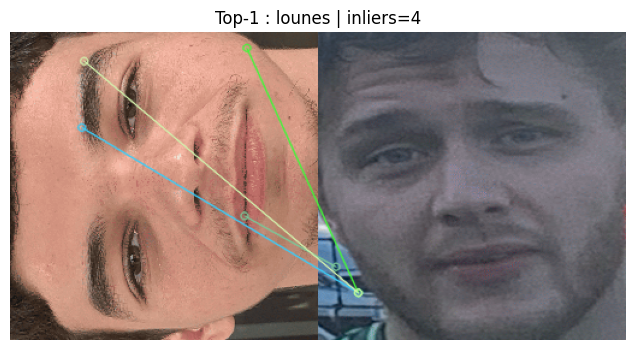

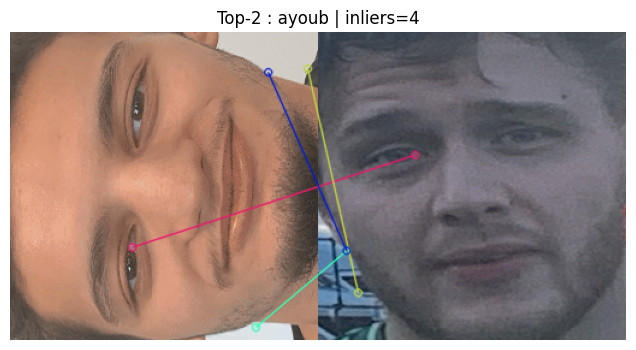

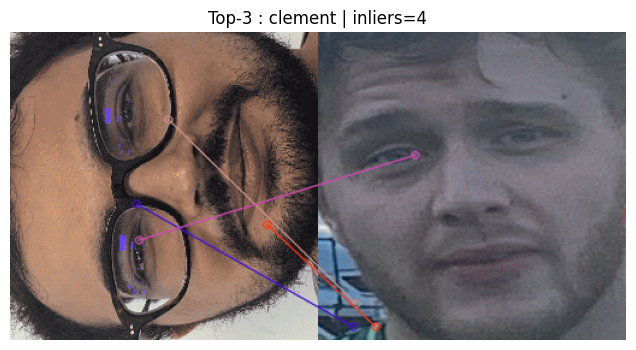


=== TEST FACE #3 | TRUE=image3 ===
Top-1: ayoub | inliers=4
Top-2: clement | inliers=4
Top-3: maxi | inliers=4


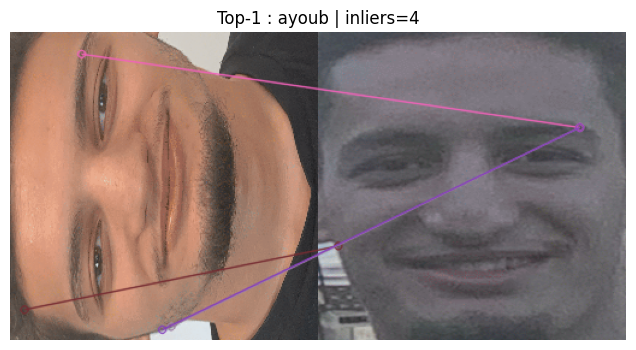

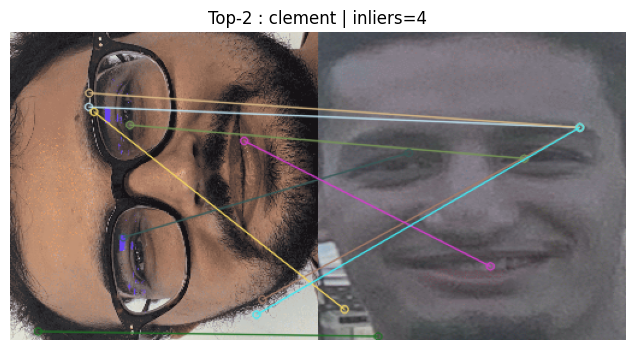

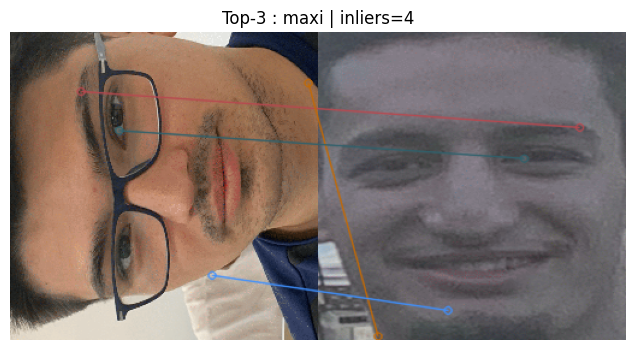


=== TEST FACE #4 | TRUE=image3 ===
Top-1: lounes | inliers=5
Top-2: ayoub | inliers=5
Top-3: maxi | inliers=5


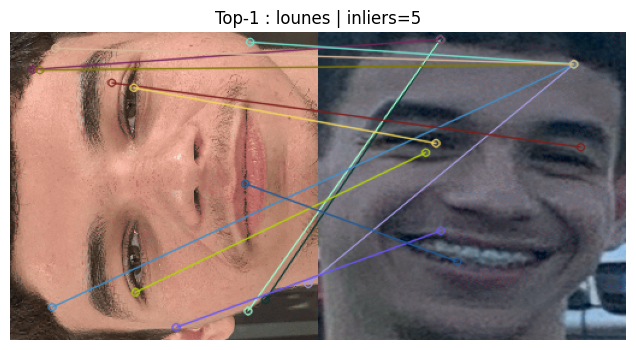

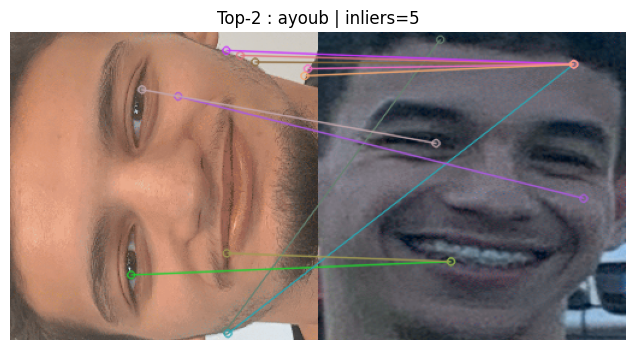

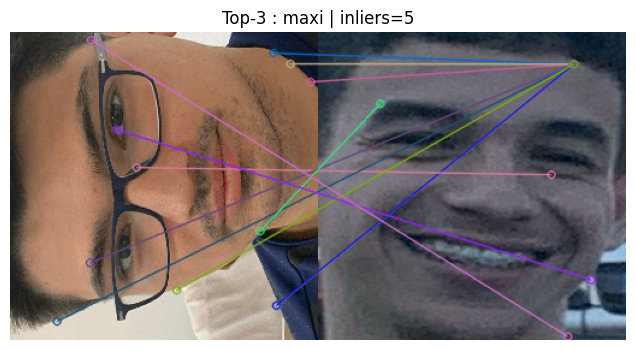


=== TEST FACE #5 | TRUE=image2 ===
Top-1: lounes | inliers=5
Top-2: sosth | inliers=5
Top-3: anthony | inliers=4


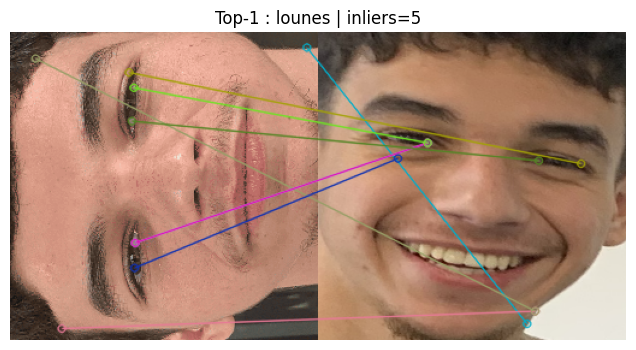

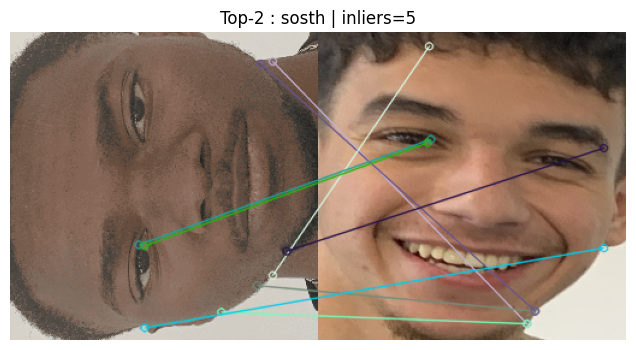

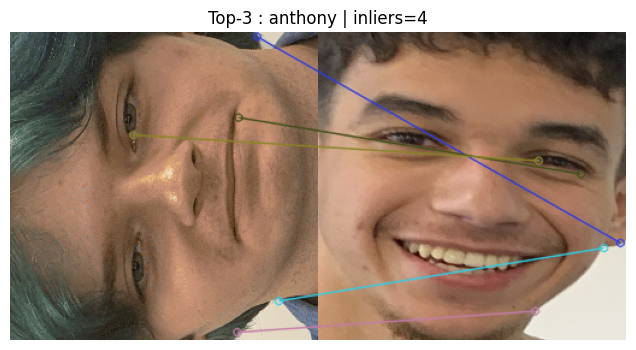


=== TEST FACE #6 | TRUE=image2 ===
Top-1: anziza | inliers=8
Top-2: ayoub | inliers=5
Top-3: lounes | inliers=4


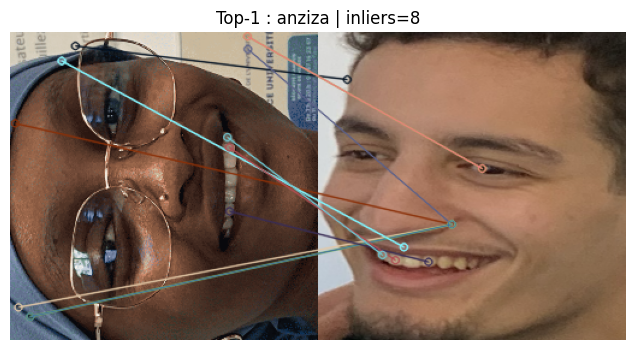

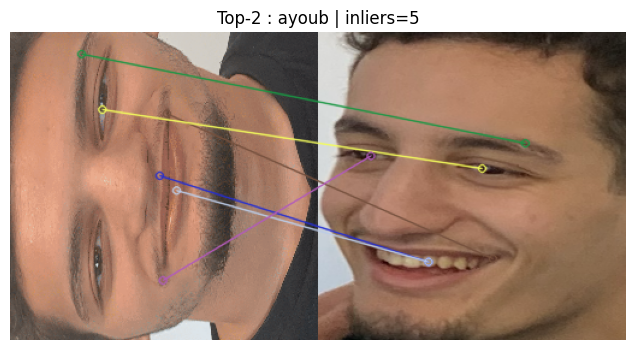

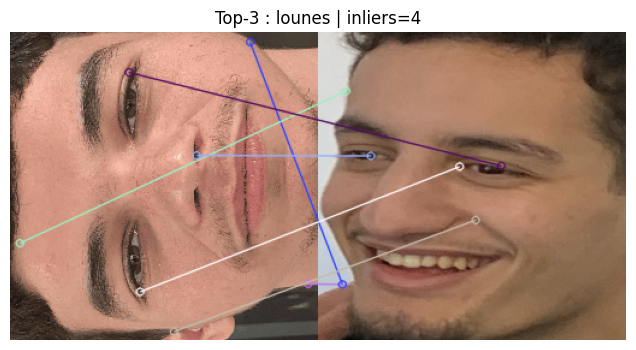

In [ ]:
y_true, y_pred, y_score = [], [], []

for idx, tf in enumerate(test_faces):

    print(f"\n=== TEST FACE #{idx+1} | TRUE={tf['true']} ===")

    top3 = top3_for_test_face(tf)

    for i, r in enumerate(top3, 1):
        print(f"Top-{i}: {r['label']} | inliers={r['score']}")

    show_top3_matches(tf, top3)

    
    y_true.append(tf["true"])
    y_pred.append(top3[0]["label"])
    y_score.append(top3[0]["score"])


In [ ]:
for s in sorted(top1_scores):
    print(s)
SEUIL_INLIERS = 8 
y_pred_known = []
for s in top1_scores:
    y_pred_known.append("known" if s >= SEUIL_INLIERS else "unknown")
print("Known :", sum(1 for x in y_pred_known if x=="known"))
print("Unknown:", sum(1 for x in y_pred_known if x=="unknown"))
for i, (s, tf) in enumerate(zip(top1_scores, test_faces)):
    if abs(s - SEUIL_INLIERS) <= 2:
        print(f"Face {i}: score={s} | pred={top1_labels[i]} | file={tf.get('file','?')} | face_id={tf.get('face_id','?')}")


4
4
5
5
8
8
Known : 2
Unknown: 4
Face 0: score=8 | pred=lounes | file=IMG_3505.png | face_id=0
Face 5: score=8 | pred=anziza | file=IMG_3461.png | face_id=1


In [ ]:
SEUIL_INLIERS = 8   

y_true = []
y_pred = []

for s in top1_scores:
    
    y_true.append("known")

   
    if s >= SEUIL_INLIERS:
        y_pred.append("known")
    else:
        y_pred.append("unknown")
from sklearn.metrics import accuracy_score

accuracy = accuracy_score(y_true, y_pred)
print("Accuracy (Known / Unknown) =", accuracy)
from sklearn.metrics import recall_score

recall_known = recall_score(y_true, y_pred, pos_label="known")
print("Recall (known) =", recall_known)


Accuracy (Known / Unknown) = 0.3333333333333333
Recall (known) = 0.3333333333333333
